<a href="https://colab.research.google.com/github/amankrpandey1/Face-recognition-V2/blob/main/Face_detection_in_low_illumination_v2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
! pip install kaggle
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
mkdir: cannot create directory ‘/root/.kaggle’: File exists


In [ ]:
! kaggle datasets download soumikrakshit/lol-dataset

lol-dataset.zip: Skipping, found more recently modified local copy (use --force to force download)


In [ ]:
from IPython.display import clear_output
! unzip /content/lol-dataset
clear_output()

In [ ]:
!pip install -q tensorflow==2.4.1

clear_output()

In [ ]:
import os
import random
import numpy as np
from glob import glob
from PIL import Image, ImageOps

import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, losses, optimizers, callbacks


AUTOTUNE = tf.data.AUTOTUNE

In [ ]:
SEED = 10
random.seed(SEED)
tf.random.set_seed(SEED)


IMAGE_SIZE = 256
MAX_TRAIN_IMAGES = 400
BATCH_SIZE = 16
TRAIN_VAL_IMAGE_DIR = "/content/lol_dataset/our485/low"
TEST_IMAGE_DIR = "/content/lol_dataset/eval15/low"
LEARNING_RATE = 1e-4
LOG_INTERVALS = 10
EPOCHS = 60

In [ ]:
train_val_image_files = glob(os.path.join(TRAIN_VAL_IMAGE_DIR, "*.png"))
test_image_files = glob(os.path.join(TEST_IMAGE_DIR, "*.png"))
train_image_files = train_val_image_files[:MAX_TRAIN_IMAGES]
val_image_files = train_val_image_files[MAX_TRAIN_IMAGES:]

print("Number of Training Images:", len(train_image_files))
print("Number of Validation Images:", len(val_image_files))
print("Number of Test Images from LOL Dataset:", len(test_image_files))

Number of Training Images: 400
Number of Validation Images: 85
Number of Test Images from LOL Dataset: 15


In [ ]:
def load_data(image_path):
    image = tf.io.read_file(image_path)
    image = tf.image.decode_png(image, channels=3)
    image = tf.image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
    image = image / 255.0
    return image


def get_dataset(images):
    dataset = tf.data.Dataset.from_tensor_slices((images))
    dataset = dataset.map(load_data, num_parallel_calls=AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=True)
    dataset = dataset.prefetch(AUTOTUNE)
    
    return dataset


train_dataset = get_dataset(train_image_files)
val_dataset = get_dataset(val_image_files)

In [ ]:
print("\033[92m") # changing print output to green 94 for blue 91 for red 93 for yellow and so on..
print("Train Data Elements:", train_dataset.element_spec)
print("Validation Data Elements:", val_dataset.element_spec)


Train Data Elements: TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None)
Validation Data Elements: TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None)


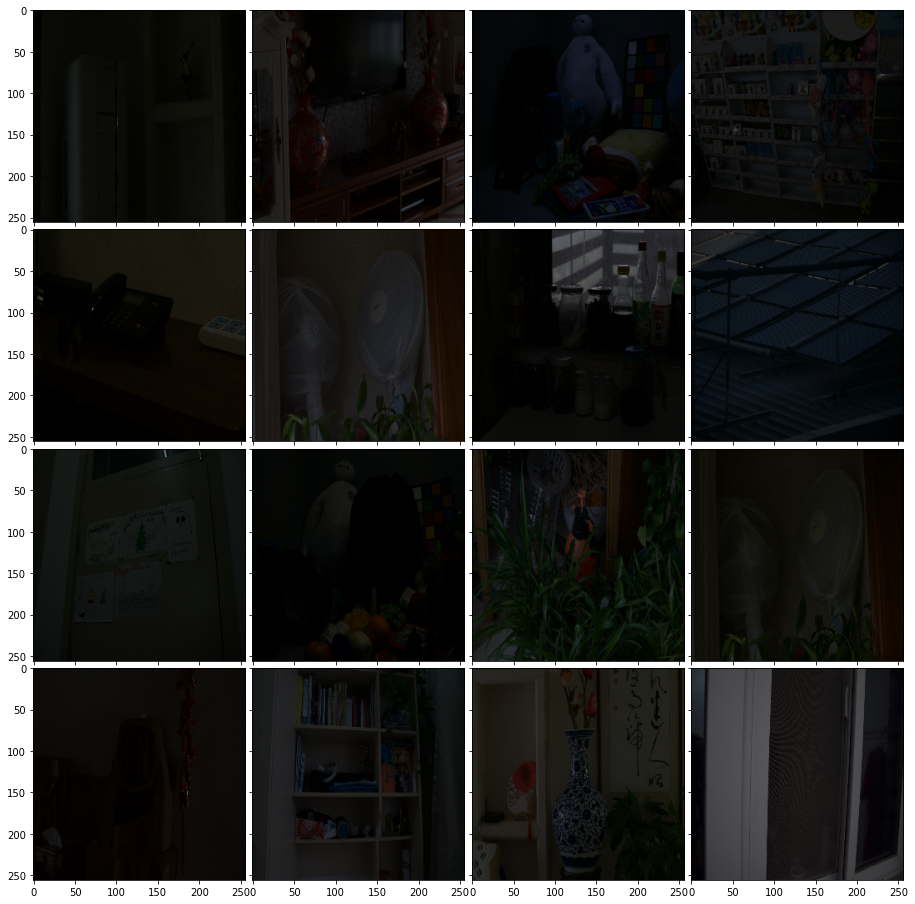

In [ ]:
images = next(iter(train_dataset)).numpy()
fig = plt.figure(figsize=(16, 16))
grid = ImageGrid(fig, 111, nrows_ncols=(4, 4), axes_pad=0.1)
random_images = images[np.random.choice(np.arange(images.shape[0]), 16)]
for ax, image in zip(grid, images):
    image = image * 255.0
    ax.imshow(image.astype(np.uint8))
plt.title("Sample Images from LOL Data")
plt.show()

In [ ]:
def build_dce_net(image_size=None):
  
  input_image = keras.Input(shape=[image_size, image_size, 3])

  conv1 = layers.Conv2D(32, (3, 3), strides=(1, 1), activation="relu", padding="same")(input_image)

  conv2 = layers.Conv2D(32, (3, 3), strides=(1, 1), activation="relu", padding="same")(conv1)

  conv3 = layers.Conv2D(32, (3, 3), strides=(1, 1), activation="relu", padding="same")(conv2)

  conv4 = layers.Conv2D(32, (3, 3), strides=(1, 1), activation="relu", padding="same")(conv3)

  int_con1 = layers.Concatenate(axis=-1)([conv4, conv3])

  conv5 = layers.Conv2D(32, (3, 3), strides=(1, 1), activation="relu", padding="same")(int_con1)

  int_con2 = layers.Concatenate(axis=-1)([conv5, conv2])

  conv6 = layers.Conv2D(32, (3, 3), strides=(1, 1), activation="relu", padding="same")(int_con2)

  int_con3 = layers.Concatenate(axis=-1)([conv6, conv1])

  x_r = layers.Conv2D(24, (3, 3), strides=(1, 1), activation="tanh", padding="same")(int_con3)

  return keras.Model(inputs=input_image, outputs=x_r)

In [ ]:
def color_constancy_loss(x): #function to check color loss
    mean_rgb = tf.reduce_mean(x, axis=(1, 2), keepdims=True)
    mean_red = mean_rgb[:, :, :, 0]
    mean_green = mean_rgb[:, :, :, 1]
    mean_blue = mean_rgb[:, :, :, 2]
    diff_red_green = tf.square(mean_red - mean_green)
    diff_red_blue = tf.square(mean_red - mean_blue)
    diff_green_blue = tf.square(mean_blue - mean_green)
    return tf.sqrt(
        tf.square(diff_red_green) + tf.square(diff_red_blue) + tf.square(diff_green_blue)
    )

In [ ]:
def exposure_loss(x, mean_val=0.6): # exposure loss
    x = tf.reduce_mean(x, axis=3, keepdims=True)
    mean = tf.nn.avg_pool2d(x, ksize=16, strides=16, padding="VALID")
    return tf.reduce_mean(tf.square(mean - mean_val))

In [ ]:
def illumination_smoothness_loss(x):
    """Inspired from https://github.com/tuvovan/Zero_DCE_TF/blob/master/src/loss.py#L28"""

    batch_size = tf.shape(x)[0]
    height_x = tf.shape(x)[1]
    width_x = tf.shape(x)[2]

    count_height = (tf.shape(x)[2] - 1) * tf.shape(x)[3]
    count_width = tf.shape(x)[2] * (tf.shape(x)[3] - 1)

    height_total_variance = tf.reduce_sum(tf.square((x[:, 1:, :, :] - x[:, : height_x - 1, :, :])))
    width_total_variance = tf.reduce_sum(tf.square((x[:, :, 1:, :] - x[:, :, : width_x - 1, :])))

    batch_size = tf.cast(batch_size, dtype=tf.float32)

    count_height = tf.cast(count_height, dtype=tf.float32)
    count_width = tf.cast(count_width, dtype=tf.float32)
    illumination_loss = 2 * (height_total_variance / count_height + width_total_variance / count_width) / batch_size
    
    return illumination_loss

In [ ]:
class SpatialConsistencyLoss(losses.Loss):
    def __init__(self, **kwargs):
        super(SpatialConsistencyLoss, self).__init__(reduction="none")

        self.left_kernel = tf.constant(
            [[[[0, 0, 0]], [[-1, 1, 0]], [[0, 0, 0]]]], dtype=tf.float32
        )
        self.right_kernel = tf.constant(
            [[[[0, 0, 0]], [[0, 1, -1]], [[0, 0, 0]]]], dtype=tf.float32
        )
        self.up_kernel = tf.constant(
            [[[[0, -1, 0]], [[0, 1, 0]], [[0, 0, 0]]]], dtype=tf.float32
        )
        self.down_kernel = tf.constant(
            [[[[0, 0, 0]], [[0, 1, 0]], [[0, -1, 0]]]], dtype=tf.float32
        )

    def call(self, y_true, y_pred):

        original_mean = tf.reduce_mean(y_true, 3, keepdims=True)
        enhanced_mean = tf.reduce_mean(y_pred, 3, keepdims=True)
        original_pool = tf.nn.avg_pool2d(
            original_mean, ksize=4, strides=4, padding="VALID"
        )
        enhanced_pool = tf.nn.avg_pool2d(
            enhanced_mean, ksize=4, strides=4, padding="VALID"
        )

        d_original_left = tf.nn.conv2d(
            original_pool, self.left_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_original_right = tf.nn.conv2d(
            original_pool, self.right_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_original_up = tf.nn.conv2d(
            original_pool, self.up_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_original_down = tf.nn.conv2d(
            original_pool, self.down_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )

        d_enhanced_left = tf.nn.conv2d(
            enhanced_pool, self.left_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_enhanced_right = tf.nn.conv2d(
            enhanced_pool, self.right_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_enhanced_up = tf.nn.conv2d(
            enhanced_pool, self.up_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )
        d_enhanced_down = tf.nn.conv2d(
            enhanced_pool, self.down_kernel, strides=[1, 1, 1, 1], padding="SAME"
        )

        d_left = tf.square(d_original_left - d_enhanced_left)
        d_right = tf.square(d_original_right - d_enhanced_right)
        d_up = tf.square(d_original_up - d_enhanced_up)
        d_down = tf.square(d_original_down - d_enhanced_down)
        return d_left + d_right + d_up + d_down

# Model Arch

In [ ]:
class ZeroDCE(keras.Model):
    def __init__(self, **kwargs):
        super(ZeroDCE, self).__init__(**kwargs)
        self.dce_model = build_dce_net()

    def compile(self, learning_rate, **kwargs):
        super(ZeroDCE, self).compile(**kwargs)
        self.optimizer = optimizers.Adam(learning_rate=learning_rate)
        self.spatial_constancy_loss = SpatialConsistencyLoss(reduction="none")
    
    def summary(self, *args, **kwargs):
        self.dce_model.summary(*args, **kwargs)

    def get_enhanced_image(self, data, output):
        x = data
        for i in range(0, 3 * 8, 3):
            r = output[:, :, :, i: i + 3]
            x = x + r * (tf.square(x) - x)
        return x

    def call(self, data):
        dce_net_output = self.dce_model(data)
        return self.get_enhanced_image(data, dce_net_output)

    def compute_losses(self, data, output):
        enhanced_image = self.get_enhanced_image(data, output)
        loss_illumination = 200 * illumination_smoothness_loss(output)
        loss_spatial_constancy = tf.reduce_mean(
            self.spatial_constancy_loss(enhanced_image, data)
        )
        loss_color_constancy = 5 * tf.reduce_mean(color_constancy_loss(enhanced_image))
        loss_exposure = 10 * tf.reduce_mean(exposure_loss(enhanced_image))
        total_loss = (
            loss_illumination
            + loss_spatial_constancy
            + loss_color_constancy
            + loss_exposure
        )
        return {
            "total_loss": total_loss,
            "illumination_smoothness_loss": loss_illumination,
            "spatial_constancy_loss": loss_spatial_constancy,
            "color_constancy_loss": loss_color_constancy,
            "exposure_loss": loss_exposure,
        }

    def train_step(self, data):
        with tf.GradientTape() as tape:
            output = self.dce_model(data)
            losses = self.compute_losses(data, output)
        gradients = tape.gradient(
            losses["total_loss"], self.dce_model.trainable_weights
        )
        self.optimizer.apply_gradients(zip(gradients, self.dce_model.trainable_weights))
        return losses

    def test_step(self, data):
        output = self.dce_model(data)
        return self.compute_losses(data, output)

    def save_weights(self, filepath, overwrite=True, save_format=None, options=None):
        """While saving the weights, we simply save the weights of the DCE-Net"""
        self.dce_model.save_weights(
            filepath, overwrite=overwrite, save_format=save_format, options=options
        )

    def load_weights(self, filepath, by_name=False, skip_mismatch=False, options=None):
        """While loading the weights, we simply load the weights of the DCE-Net"""
        self.dce_model.load_weights(
            filepath=filepath,
            by_name=by_name,
            skip_mismatch=skip_mismatch,
            options=options,
        )

In [ ]:
zero_dce_model = ZeroDCE()
zero_dce_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv2d (Conv2D)                (None, None, None,   896         ['input_1[0][0]']                
                                32)                                                               
                                                                                                  
 conv2d_1 (Conv2D)              (None, None, None,   9248        ['conv2d[0][0]']                 
                                32)                                                           

In [ ]:
def plot_results(images, titles, figure_size=(12, 12)):
    fig = plt.figure(figsize=figure_size)
    for i in range(len(images)):
        fig.add_subplot(1, len(images), i + 1).set_title(titles[i])
        _ = plt.imshow(images[i])
        plt.axis("off")
    plt.show()


def infer(original_image):
    image = keras.preprocessing.image.img_to_array(original_image)
    image = image[:, :, :3] if image.shape[-1] > 3 else image
    image = image.astype("float32") / 255.0
    image = np.expand_dims(image, axis=0)
    output_image = zero_dce_model(image)
    output_image = tf.cast((output_image[0, :, :, :] * 255), dtype=np.uint8)
    output_image = Image.fromarray(output_image.numpy())
    return output_image

In [ ]:
class LogPredictionCallback(callbacks.Callback):
    
    def __init__(self, image_files, log_interval, *args, **kwargs):
        super().__init__(*args, **kwargs)
        self.image_files = image_files
        self.log_interval = log_interval
    
    def on_epoch_end(self, epoch, logs=None):
        if epoch % self.log_interval == 0: 
            for image_file in self.image_files:
                original_image = Image.open(image_file)
                enhanced_image = infer(original_image)
                plot_results(
                    [original_image, enhanced_image],
                    ["Original", "Enhanced_Image"],
                    (15, 7),
                )

Epoch 1/60
 6/25 [======>.......................] - ETA: 5s - total_loss: 5.6192 - illumination_smoothness_loss: 2.7251 - spatial_constancy_loss: 1.3567e-05 - color_constancy_loss: 0.0035 - exposure_loss: 2.8905

25/25 [==============================] - ETA: 0s - total_loss: 4.9434 - illumination_smoothness_loss: 2.0003 - spatial_constancy_loss: 1.0531e-05 - color_constancy_loss: 0.0032 - exposure_loss: 2.9399

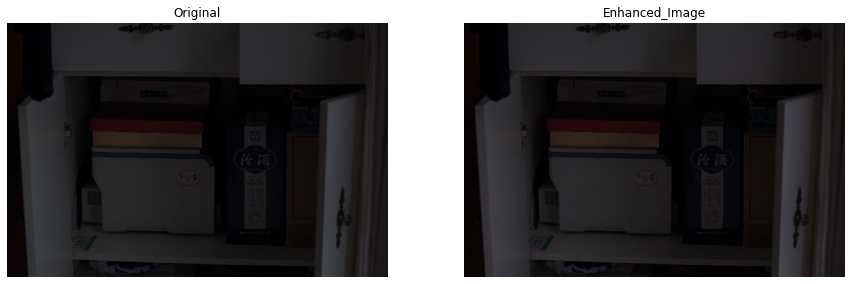

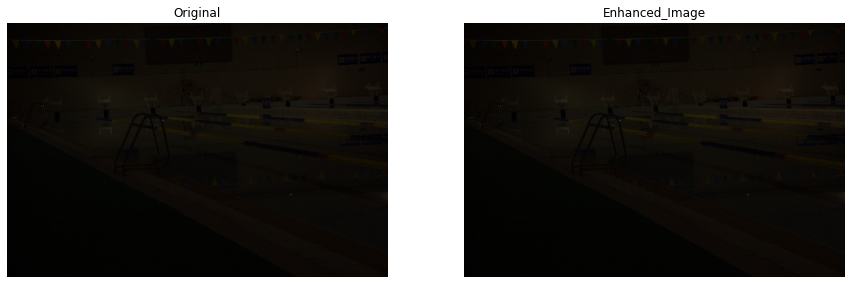

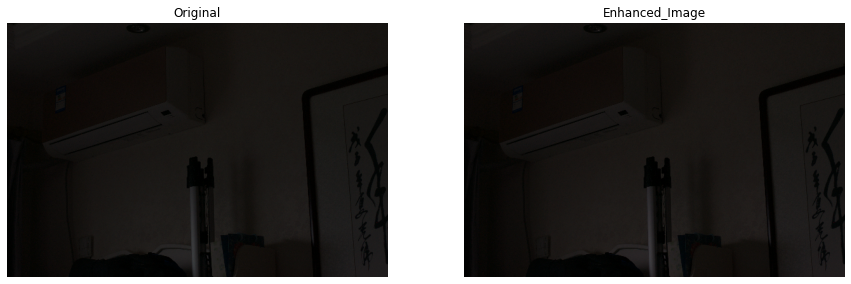

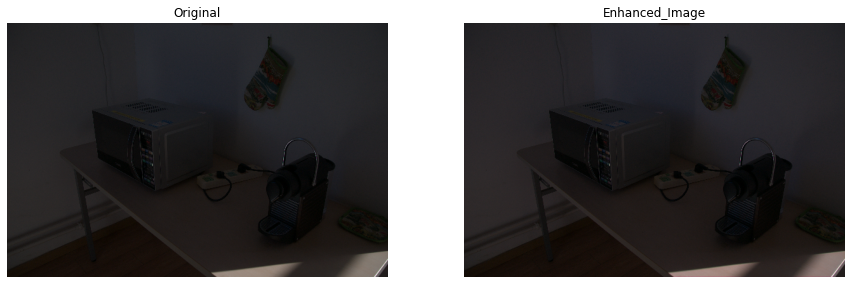

25/25 [==============================] - 21s 516ms/step - total_loss: 4.9123 - illumination_smoothness_loss: 1.9714 - spatial_constancy_loss: 1.0543e-05 - color_constancy_loss: 0.0031 - exposure_loss: 2.9377 - val_total_loss: 4.0309 - val_illumination_smoothness_loss: 1.1172 - val_spatial_constancy_loss: 8.1588e-06 - val_color_constancy_loss: 0.0019 - val_exposure_loss: 2.9118
Epoch 2/60
25/25 [==============================] - 9s 337ms/step - total_loss: 4.0896 - illumination_smoothness_loss: 1.1607 - spatial_constancy_loss: 2.8996e-05 - color_constancy_loss: 0.0030 - exposure_loss: 2.9258 - val_total_loss: 3.6331 - val_illumination_smoothness_loss: 0.7356 - val_spatial_constancy_loss: 3.0285e-05 - val_color_constancy_loss: 0.0019 - val_exposure_loss: 2.8956
Epoch 3/60
25/25 [==============================] - 8s 307ms/step - total_loss: 3.7175 - illumination_smoothness_loss: 0.8029 - spatial_constancy_loss: 6.4780e-05 - color_constancy_loss: 0.0030 - exposure_loss: 2.9116 - val_total_

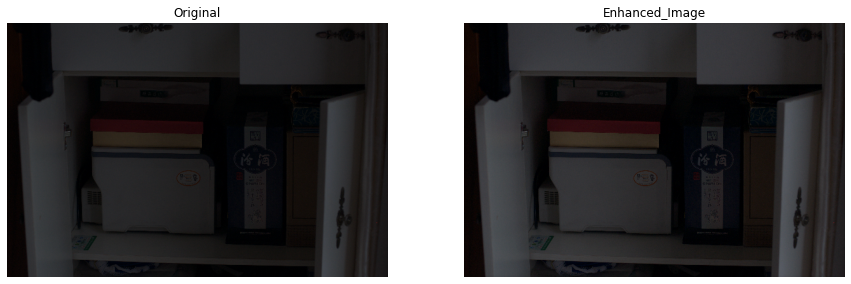

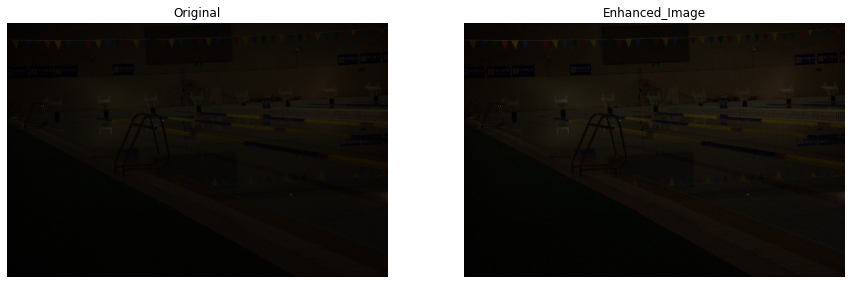

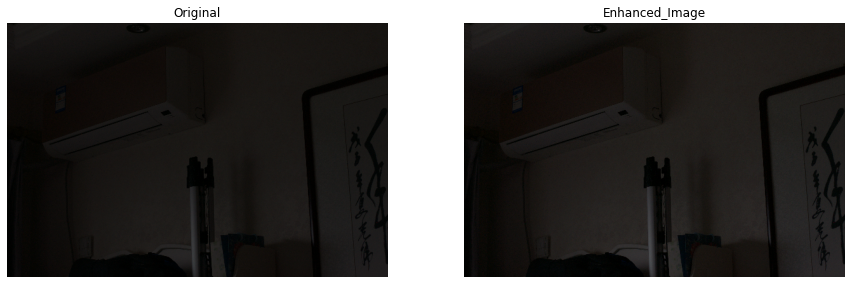

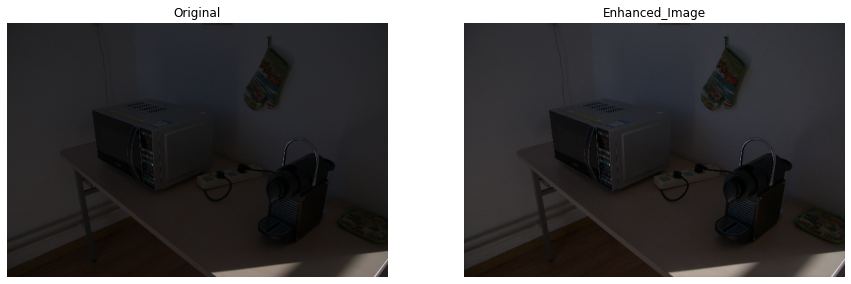

25/25 [==============================] - 10s 387ms/step - total_loss: 2.9331 - illumination_smoothness_loss: 0.1550 - spatial_constancy_loss: 8.4570e-04 - color_constancy_loss: 0.0039 - exposure_loss: 2.7734 - val_total_loss: 2.8388 - val_illumination_smoothness_loss: 0.1120 - val_spatial_constancy_loss: 8.7347e-04 - val_color_constancy_loss: 0.0029 - val_exposure_loss: 2.7230
Epoch 12/60
25/25 [==============================] - 9s 340ms/step - total_loss: 2.8936 - illumination_smoothness_loss: 0.1424 - spatial_constancy_loss: 0.0011 - color_constancy_loss: 0.0042 - exposure_loss: 2.7459 - val_total_loss: 2.7994 - val_illumination_smoothness_loss: 0.1072 - val_spatial_constancy_loss: 0.0012 - val_color_constancy_loss: 0.0032 - val_exposure_loss: 2.6879
Epoch 13/60
25/25 [==============================] - 8s 311ms/step - total_loss: 2.8509 - illumination_smoothness_loss: 0.1361 - spatial_constancy_loss: 0.0015 - color_constancy_loss: 0.0046 - exposure_loss: 2.7087 - val_total_loss: 2.75

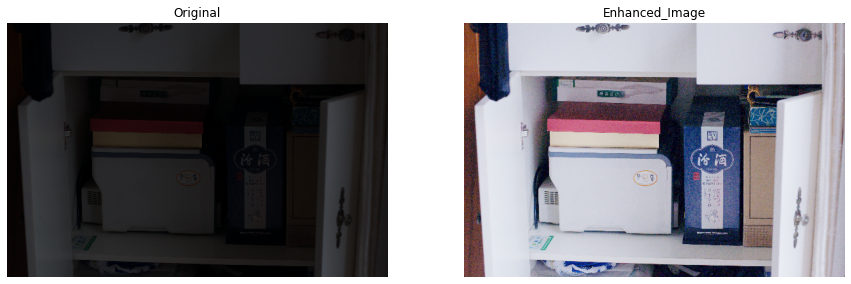

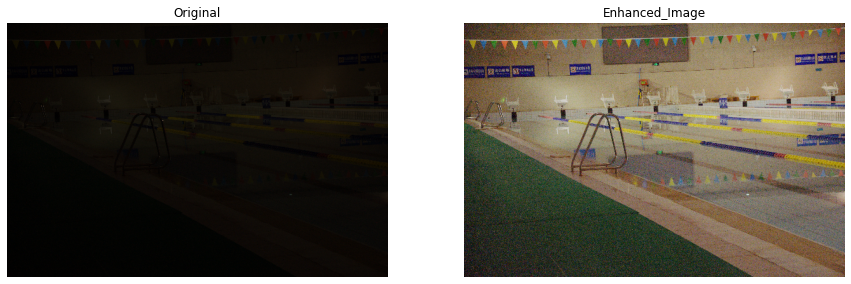

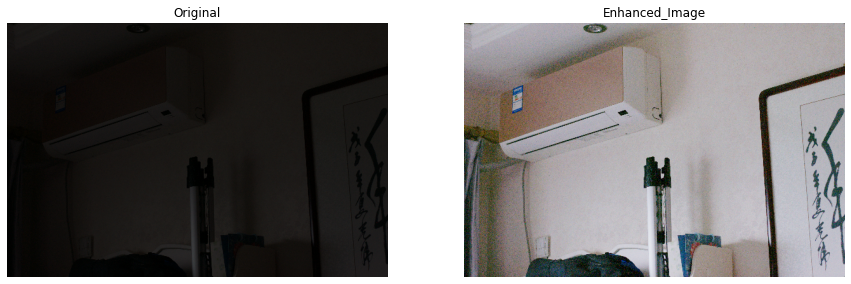

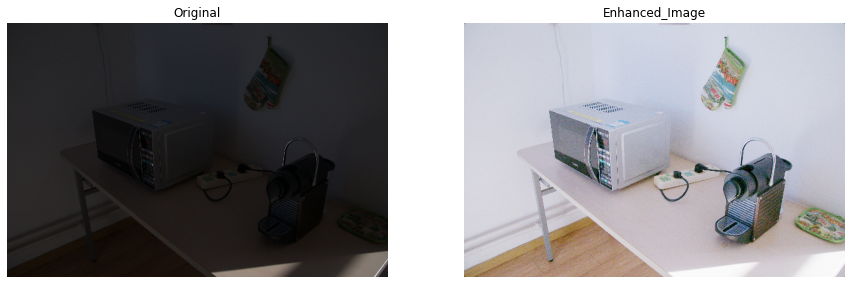

25/25 [==============================] - 10s 387ms/step - total_loss: 1.2316 - illumination_smoothness_loss: 0.1608 - spatial_constancy_loss: 0.2716 - color_constancy_loss: 0.0783 - exposure_loss: 0.7209 - val_total_loss: 0.9954 - val_illumination_smoothness_loss: 0.1405 - val_spatial_constancy_loss: 0.3061 - val_color_constancy_loss: 0.0721 - val_exposure_loss: 0.4767
Epoch 22/60
25/25 [==============================] - 8s 309ms/step - total_loss: 1.2215 - illumination_smoothness_loss: 0.1514 - spatial_constancy_loss: 0.2732 - color_constancy_loss: 0.0785 - exposure_loss: 0.7184 - val_total_loss: 0.9874 - val_illumination_smoothness_loss: 0.1325 - val_spatial_constancy_loss: 0.3083 - val_color_constancy_loss: 0.0726 - val_exposure_loss: 0.4740
Epoch 23/60
25/25 [==============================] - 8s 335ms/step - total_loss: 1.2129 - illumination_smoothness_loss: 0.1432 - spatial_constancy_loss: 0.2744 - color_constancy_loss: 0.0788 - exposure_loss: 0.7166 - val_total_loss: 0.9805 - val

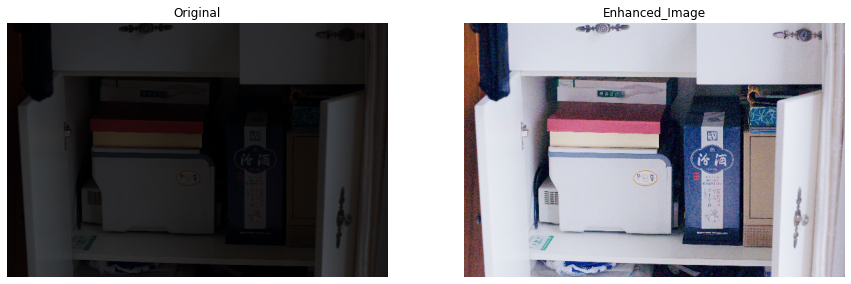

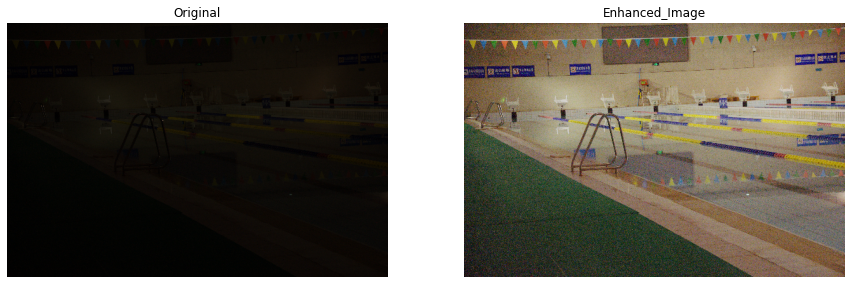

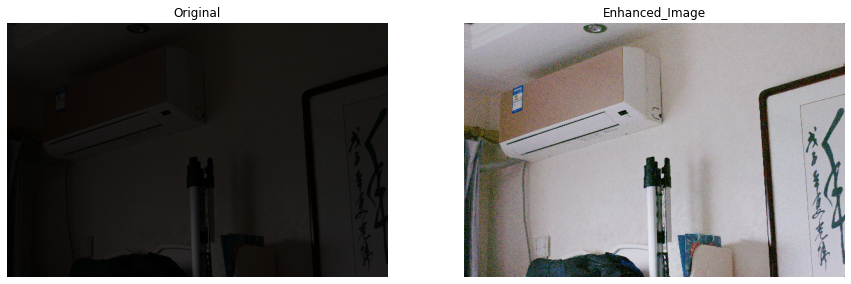

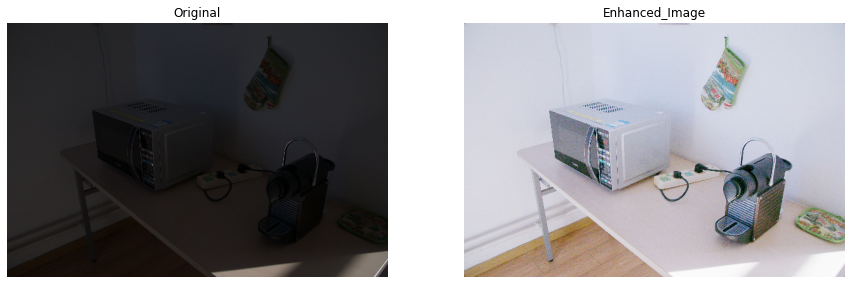

25/25 [==============================] - 10s 411ms/step - total_loss: 1.1590 - illumination_smoothness_loss: 0.0916 - spatial_constancy_loss: 0.2823 - color_constancy_loss: 0.0800 - exposure_loss: 0.7051 - val_total_loss: 0.9349 - val_illumination_smoothness_loss: 0.0790 - val_spatial_constancy_loss: 0.3207 - val_color_constancy_loss: 0.0743 - val_exposure_loss: 0.4608
Epoch 32/60
25/25 [==============================] - 8s 309ms/step - total_loss: 1.1534 - illumination_smoothness_loss: 0.0862 - spatial_constancy_loss: 0.2834 - color_constancy_loss: 0.0802 - exposure_loss: 0.7037 - val_total_loss: 0.9302 - val_illumination_smoothness_loss: 0.0741 - val_spatial_constancy_loss: 0.3220 - val_color_constancy_loss: 0.0745 - val_exposure_loss: 0.4596
Epoch 33/60
25/25 [==============================] - 8s 336ms/step - total_loss: 1.1483 - illumination_smoothness_loss: 0.0812 - spatial_constancy_loss: 0.2842 - color_constancy_loss: 0.0803 - exposure_loss: 0.7025 - val_total_loss: 0.9259 - val

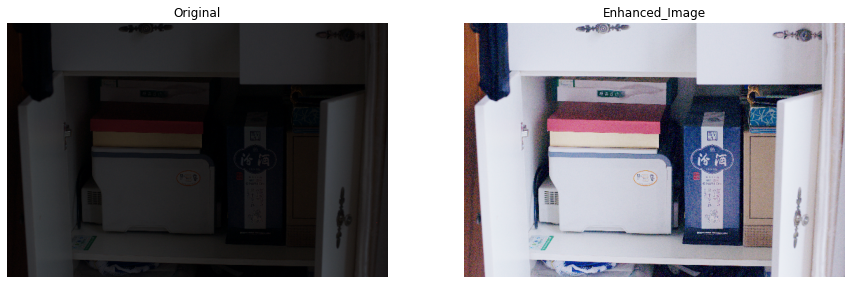

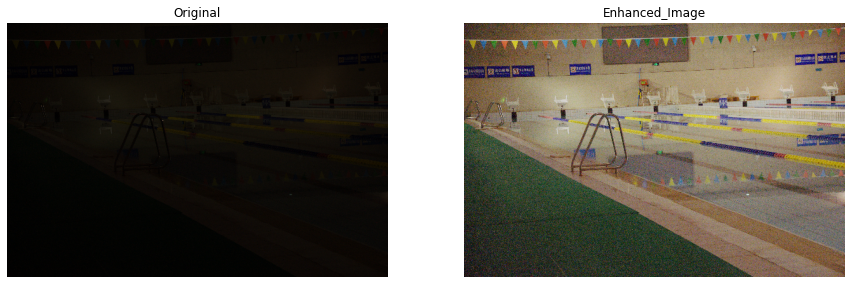

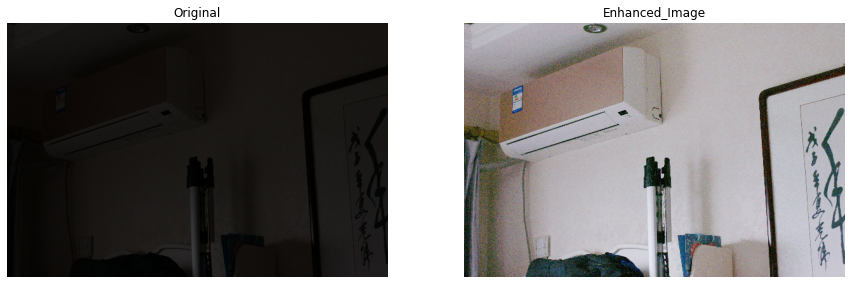

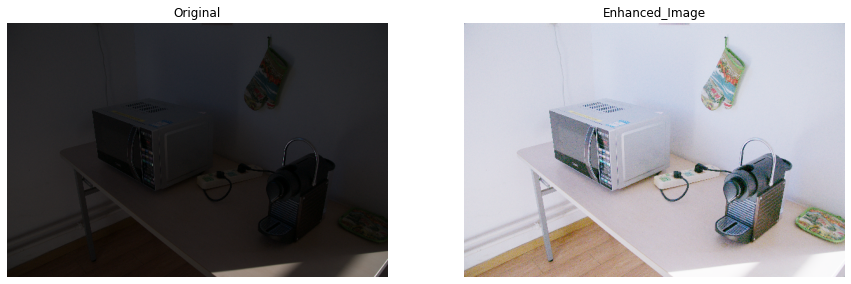

25/25 [==============================] - 10s 379ms/step - total_loss: 1.1162 - illumination_smoothness_loss: 0.0505 - spatial_constancy_loss: 0.2908 - color_constancy_loss: 0.0814 - exposure_loss: 0.6935 - val_total_loss: 0.8989 - val_illumination_smoothness_loss: 0.0412 - val_spatial_constancy_loss: 0.3297 - val_color_constancy_loss: 0.0753 - val_exposure_loss: 0.4527
Epoch 42/60
25/25 [==============================] - 8s 301ms/step - total_loss: 1.1133 - illumination_smoothness_loss: 0.0477 - spatial_constancy_loss: 0.2909 - color_constancy_loss: 0.0814 - exposure_loss: 0.6933 - val_total_loss: 0.8965 - val_illumination_smoothness_loss: 0.0387 - val_spatial_constancy_loss: 0.3307 - val_color_constancy_loss: 0.0754 - val_exposure_loss: 0.4517
Epoch 43/60
25/25 [==============================] - 8s 315ms/step - total_loss: 1.1106 - illumination_smoothness_loss: 0.0451 - spatial_constancy_loss: 0.2919 - color_constancy_loss: 0.0816 - exposure_loss: 0.6920 - val_total_loss: 0.8949 - val

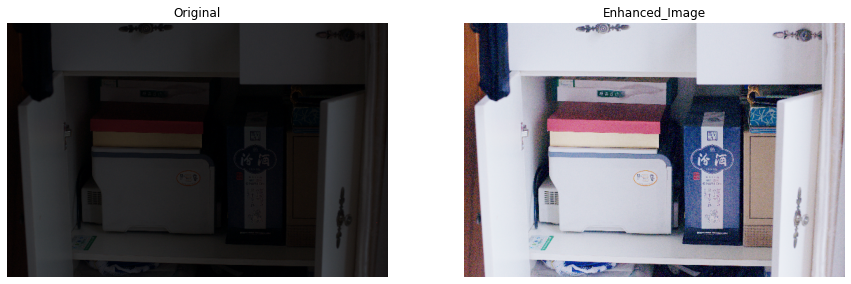

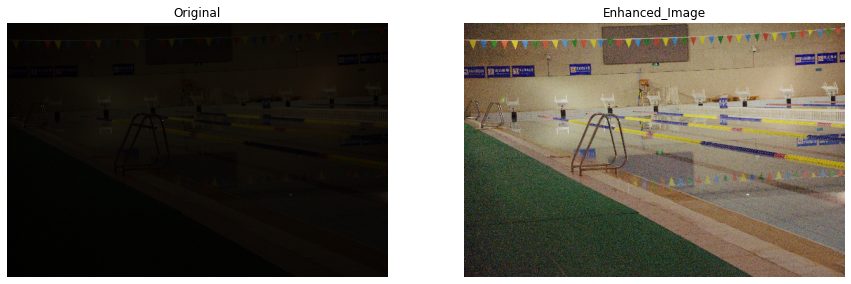

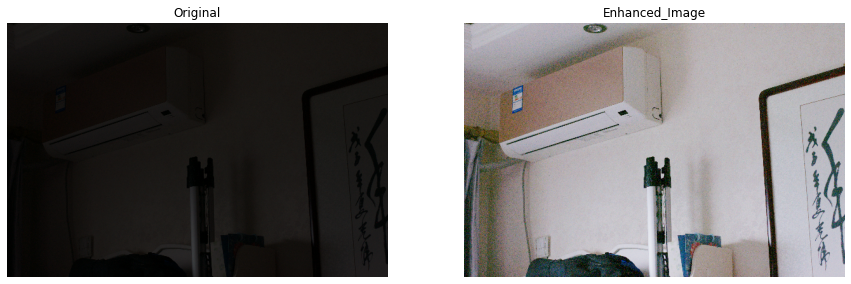

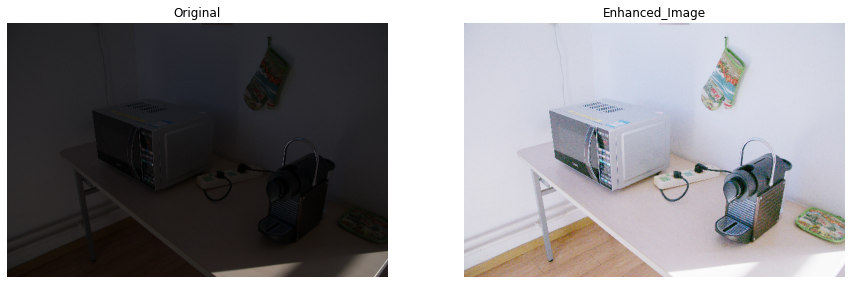

25/25 [==============================] - 10s 378ms/step - total_loss: 1.0942 - illumination_smoothness_loss: 0.0308 - spatial_constancy_loss: 0.2944 - color_constancy_loss: 0.0820 - exposure_loss: 0.6870 - val_total_loss: 0.8814 - val_illumination_smoothness_loss: 0.0238 - val_spatial_constancy_loss: 0.3347 - val_color_constancy_loss: 0.0759 - val_exposure_loss: 0.4470
Epoch 52/60
25/25 [==============================] - 8s 309ms/step - total_loss: 1.0926 - illumination_smoothness_loss: 0.0296 - spatial_constancy_loss: 0.2955 - color_constancy_loss: 0.0822 - exposure_loss: 0.6852 - val_total_loss: 0.8803 - val_illumination_smoothness_loss: 0.0229 - val_spatial_constancy_loss: 0.3350 - val_color_constancy_loss: 0.0759 - val_exposure_loss: 0.4466
Epoch 53/60
25/25 [==============================] - 8s 315ms/step - total_loss: 1.0912 - illumination_smoothness_loss: 0.0284 - spatial_constancy_loss: 0.2952 - color_constancy_loss: 0.0822 - exposure_loss: 0.6854 - val_total_loss: 0.8792 - val

In [ ]:
zero_dce_model.compile(learning_rate=LEARNING_RATE)

history = zero_dce_model.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=EPOCHS,
    callbacks=[
        LogPredictionCallback(
            image_files=random.sample(val_image_files, 4),
            log_interval=LOG_INTERVALS
        )
    ]
)

In [ ]:
def plot_result(item):
    plt.plot(history.history[item], label=item)
    plt.plot(history.history["val_" + item], label="val_" + item)
    plt.xlabel("Epochs")
    plt.ylabel(item)
    plt.title("Train and Validation {} Over Epochs".format(item), fontsize=14)
    plt.legend()
    plt.grid()
    plt.show()


plot_result("total_loss")
plot_result("illumination_smoothness_loss")
plot_result("spatial_constancy_loss")
plot_result("color_constancy_loss")
plot_result("exposure_loss")

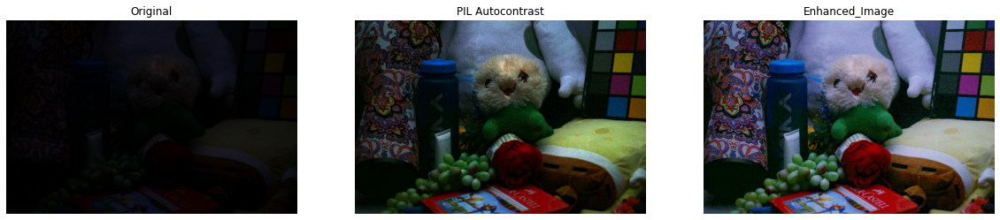

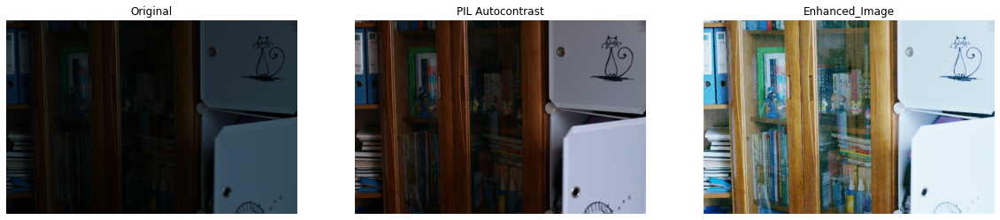

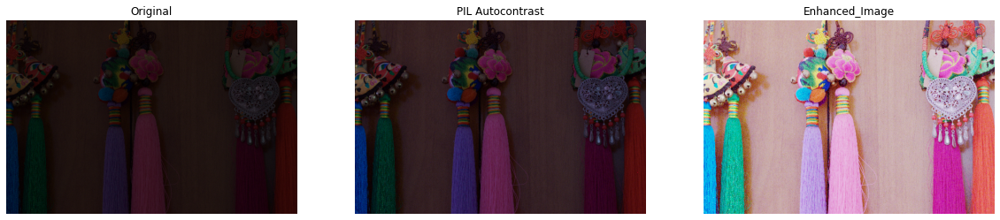

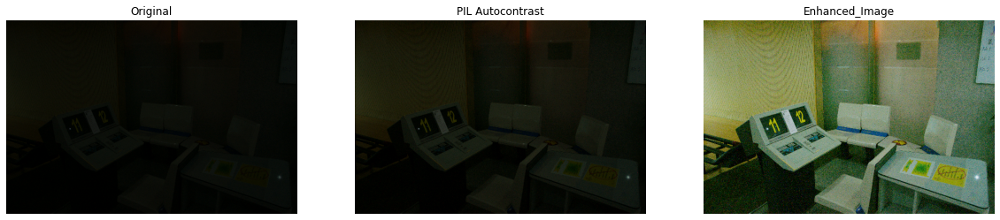

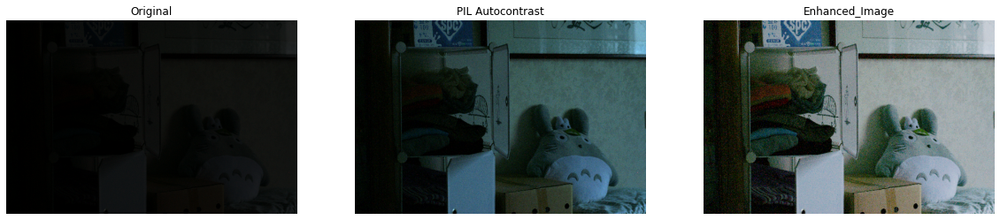

...

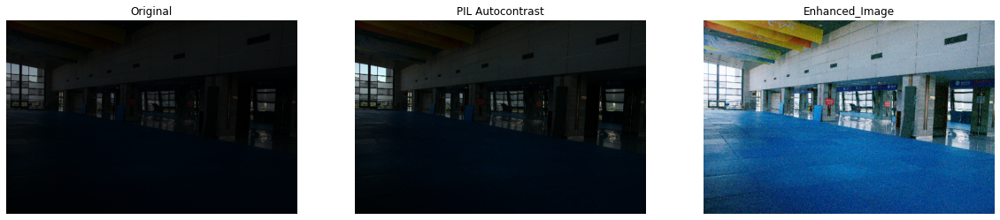

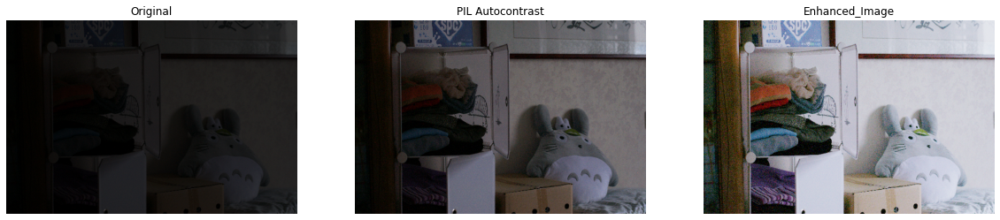

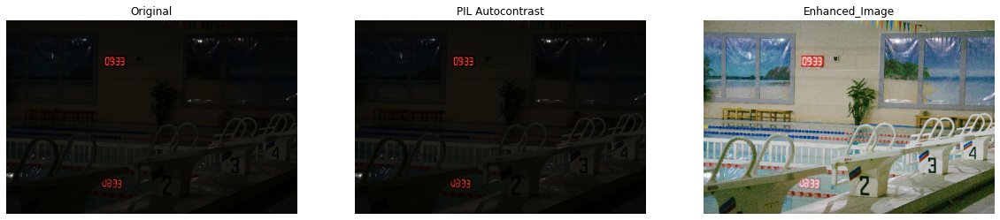

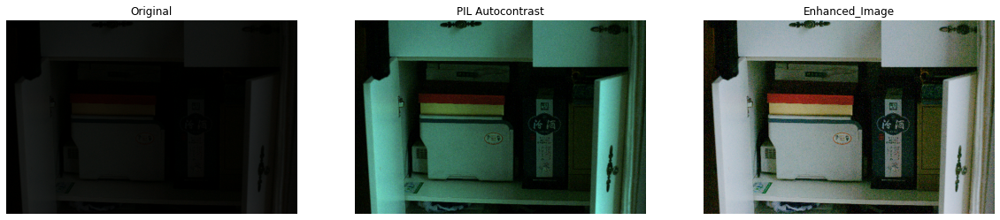

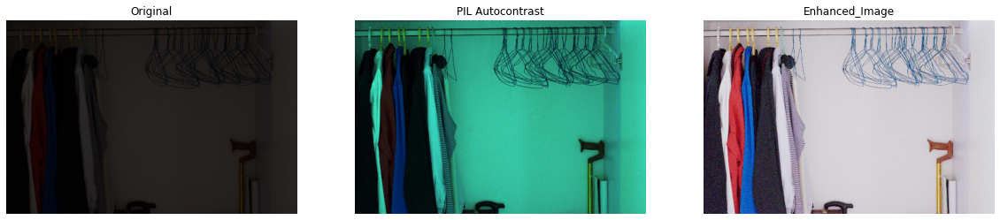

In [ ]:
for image_file in test_image_files:
    original_image = Image.open(image_file)
    enhanced_image = infer(original_image)
    plot_results(
        [original_image, ImageOps.autocontrast(original_image), enhanced_image],
        ["Original", "PIL Autocontrast", "Enhanced_Image"],
        (20, 12),
    )

In [ ]:
model_json = zero_dce_model.to_json()
with open("lol_model.json", "w") as json_file:
  json_file.write(model_json)
zero_dce_model.save_weights("lol_model.h5")
print("Saved model to disk")

Saved model to disk


In [ ]:
test_image_files

['/content/lol_dataset/eval15/low/493.png',
 '/content/lol_dataset/eval15/low/1.png',
 '/content/lol_dataset/eval15/low/179.png',
 '/content/lol_dataset/eval15/low/665.png',
 '/content/lol_dataset/eval15/low/23.png',
 '/content/lol_dataset/eval15/low/79.png',
 '/content/lol_dataset/eval15/low/547.png',
 '/content/lol_dataset/eval15/low/111.png',
 '/content/lol_dataset/eval15/low/778.png',
 '/content/lol_dataset/eval15/low/669.png',
 '/content/lol_dataset/eval15/low/780.png',
 '/content/lol_dataset/eval15/low/22.png',
 '/content/lol_dataset/eval15/low/748.png',
 '/content/lol_dataset/eval15/low/55.png',
 '/content/lol_dataset/eval15/low/146.png']

#Load weights

In [ ]:
zero_dce_model.save("best_model", save_format="tf")

In [ ]:
zero_dce_model_1 = tf.keras.models.load_model('best_model')

def infer(original_image):
    image = keras.preprocessing.image.img_to_array(original_image)
    image = image[:, :, :3] if image.shape[-1] > 3 else image
    image = image.astype("float32") / 255.0
    image = np.expand_dims(image, axis=0)
    output_image = zero_dce_model_1(image)
    output_image = tf.cast((output_image[0, :, :, :] * 255), dtype=np.uint8)
    output_image = Image.fromarray(output_image.numpy())
    return output_image

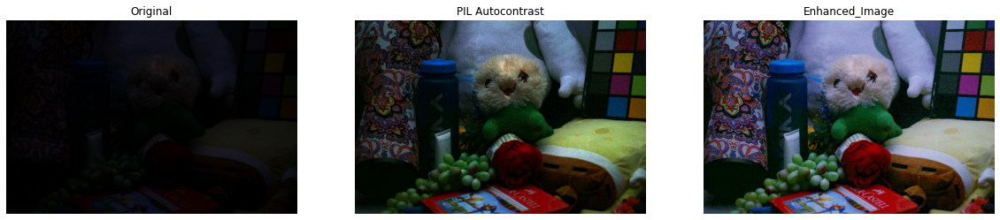

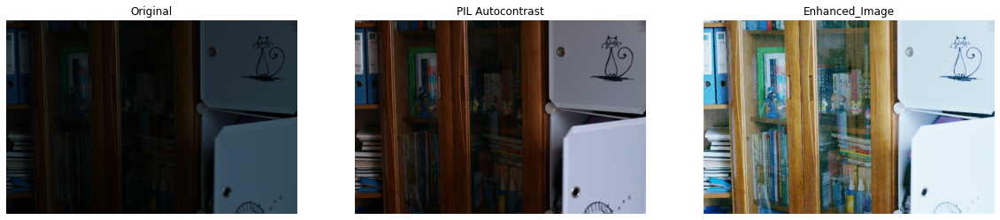

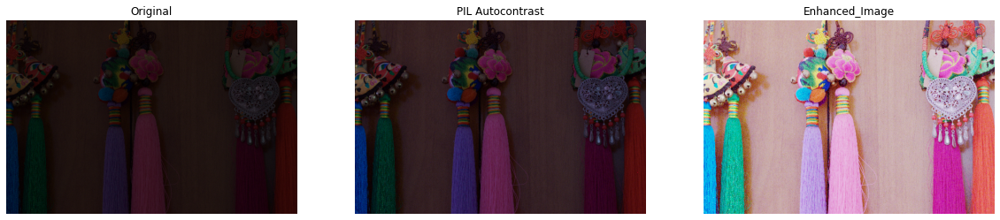

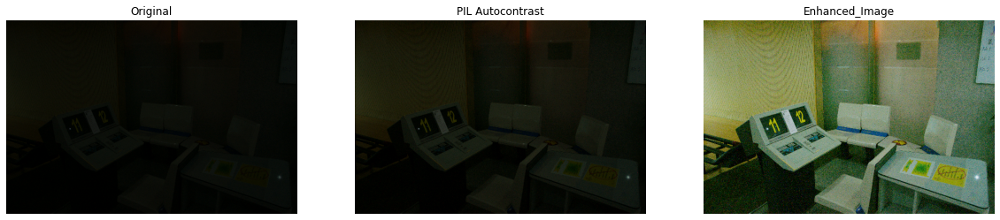

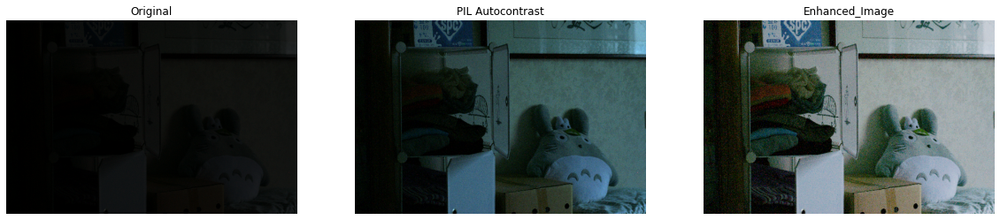

...

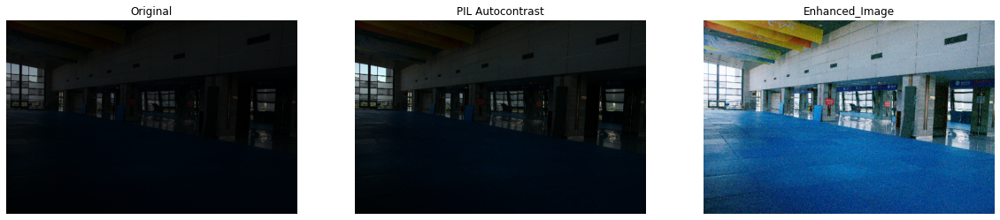

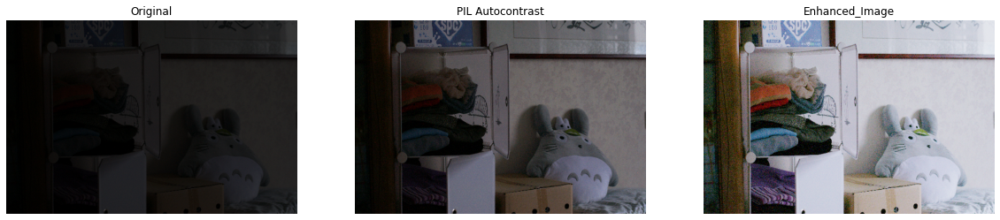

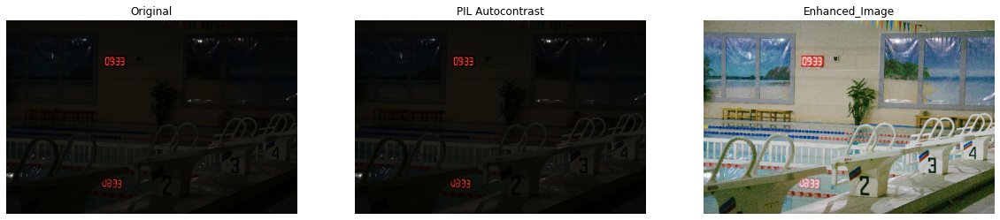

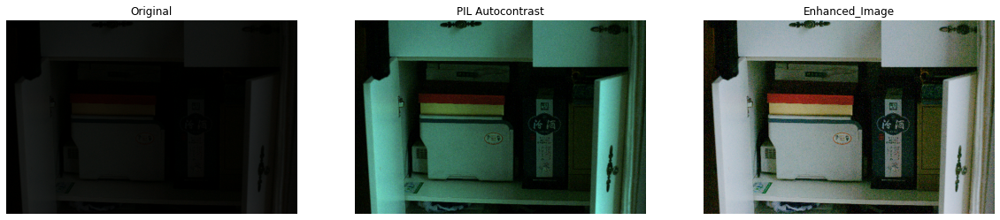

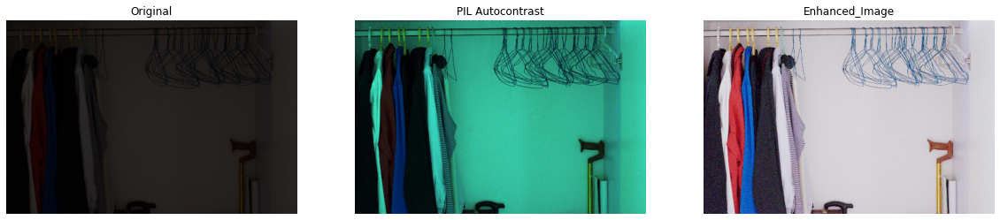

In [ ]:
for image_file in test_image_files:
    original_image = Image.open(image_file)
    enhanced_image = infer(original_image)
    plot_results(
        [original_image, ImageOps.autocontrast(original_image), enhanced_image],
        ["Original", "PIL Autocontrast", "Enhanced_Image"],
        (20, 12),
    )